In [1]:
import pyedflib # ref: https://pyedflib.readthedocs.io/en/latest/
import pandas as pd
import numpy as np
import os
from datetime import timedelta
import matplotlib.pyplot as plt
from scipy import signal
import fnmatch

In [2]:
sth = "20231006"
threshold = 30

read_folder = './clips/'
write_folder = f'./plots_n1_{threshold}/'
os.makedirs(write_folder, exist_ok=True)
pattern1 = '*-PSG.edf'
pattern2 = '*-Hypnogram.edf'

psg_list = sorted([f for f in os.listdir(read_folder) if fnmatch.fnmatch(f, pattern1)])
hypnogram_list = sorted([f for f in os.listdir(read_folder) if fnmatch.fnmatch(f, pattern2)])
psg_iter = iter(psg_list)
hypnogram_iter = iter(hypnogram_list)

channels = ['EEG Fpz-Cz', 'EEG Pz-Oz']
channel = channels[1]
psg_id = None
hypnogram_id = None

In [3]:
import matplotlib.pyplot as plt
import matplotlib.ticker as plticker
import matplotlib.dates as mdates
import pandas as pd
def lol(signal_df):
    num_columns = len(signal_df.columns)

    fig, axes = plt.subplots(num_columns, 1, figsize=(20, 12), sharex=True)

    # 迴圈遍歷每個欄位
    for i, column in enumerate(signal_df.columns):
        # 取得目前的軸
        ax = axes[i]

        # 繪製折線圖
        ax.plot(signal_df.index, signal_df[column])
        
        # 繪製虛線
        start_time = signal_df.index[0]
        end_time = signal_df.index[-1]
        interval = pd.Timedelta(seconds=30)
        current_time = start_time + interval
        while current_time < end_time:
            ax.axvline(x=current_time, linestyle='--', color='gray')
            current_time += interval

        # 設定軸的標籤
        ax.set_ylabel(column)
        loc = mdates.MinuteLocator(interval=1)
        ax.xaxis.set_major_locator(loc)
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M'))

    # 設定圖表標題和共用 x 軸標籤
    fig.suptitle('Signal Visualization')
    axes[-1].set_xlabel('Time')

    # 調整子圖之間的間距
    plt.tight_layout()
    # 顯示圖表
    # plt.show()
    plt.savefig(write_folder + psg_id.split('.')[0],bbox_inches='tight')


In [4]:
def get_n1_index(signal_df, threshold=25):
    index = []
    index_series = []
    # 0, 3000, 6000
    N = signal_df.shape[0]
    # # FIXED VARIABLE
    # threshold = 25

    for i in range(0, N, 1500):
        mxcount = 0
        count = 0
        try:
            for j in range(3000):
                if(abs(signal_df.iloc[i+j,0]) < threshold and abs(signal_df.iloc[i+j-1,0]) < threshold):
                    count += 1
                else:
                    if(count > mxcount):
                        mxcount = count
                    count = 0
            mxcount = max(mxcount, count)
        except:
            pass
        # print(i,mxcount)
        index_series.append(mxcount)
        if(mxcount > 1500):
            index.append(i)
    # len(index)
    return index

SC405100E0-PSG.edf0/10
SC406100E0-PSG.edf1/12
SC408200E0-PSG.edf2/17
SC409200E0-PSG.edf3/19


/tmp/ipykernel_378514/250010612.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(num_columns, 1, figsize=(20, 12), sharex=True)


SC422200E0-PSG.edf4/43
SC423200E0-PSG.edf5/45
SC424200E0-PSG.edf6/47
SC427100F0-PSG.edf7/52
SC429100G0-PSG.edf8/56
SC429200G0-PSG.edf9/57
SC431100E0-PSG.edf10/60
SC431200E0-PSG.edf11/61
SC441100E0-PSG.edf12/77
SC441200E0-PSG.edf13/78
SC442100E0-PSG.edf14/79
SC444100E0-PSG.edf15/83
SC444200E0-PSG.edf16/84
SC447100F0-PSG.edf17/89
SC447200F0-PSG.edf18/90
SC448100F0-PSG.edf19/91
SC448200F0-PSG.edf20/92
SC449100G0-PSG.edf21/93
SC450200E0-PSG.edf22/96
SC453100E0-PSG.edf23/100
SC458200G0-PSG.edf24/111
SC466100E0-PSG.edf25/125
SC477200G0-PSG.edf26/144
SC481200G0-PSG.edf27/147
SC482100G0-PSG.edf28/148
SC482200G0-PSG.edf29/149
Iter Stopt/total: 30/150


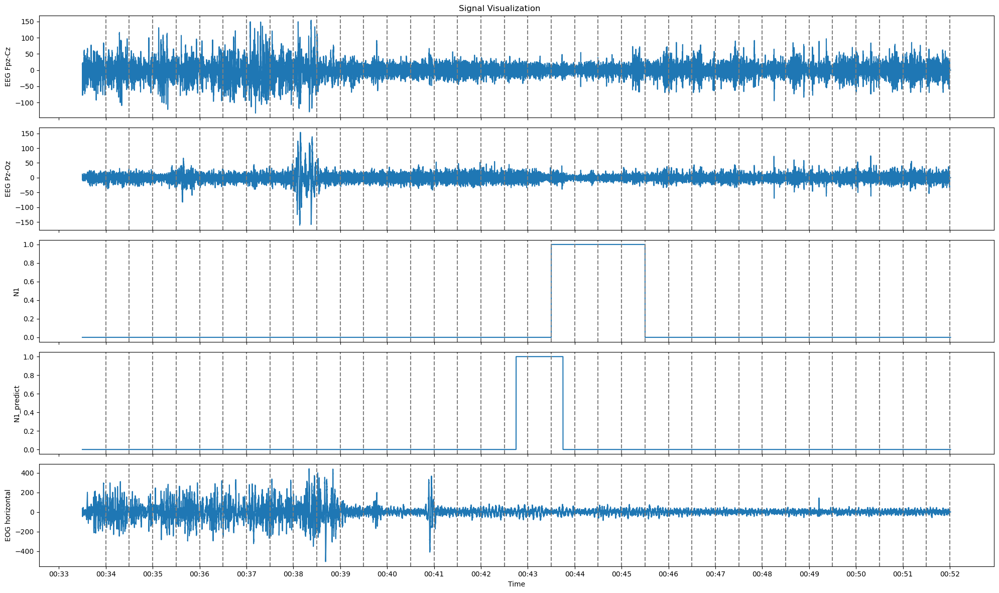

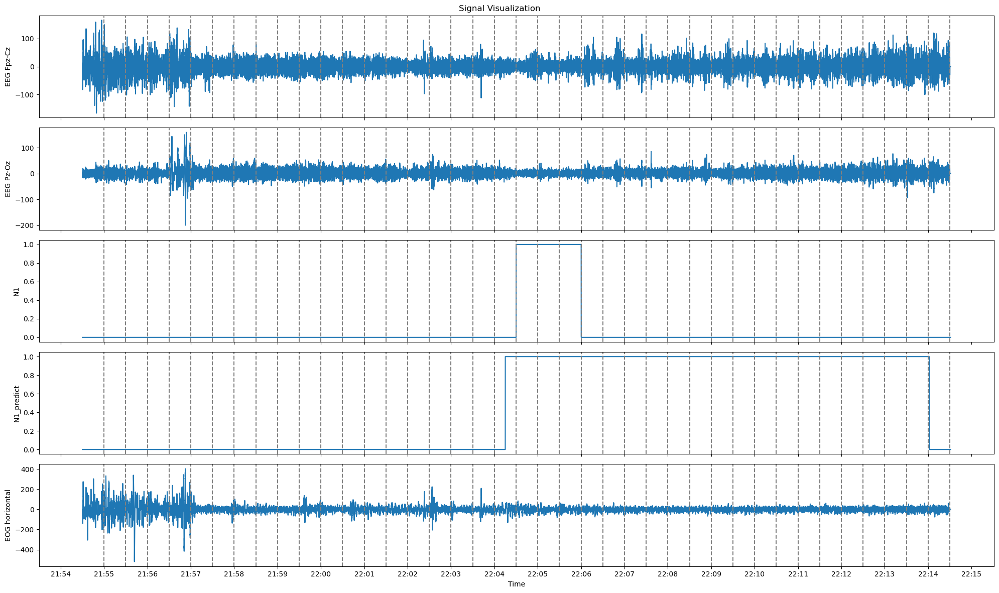

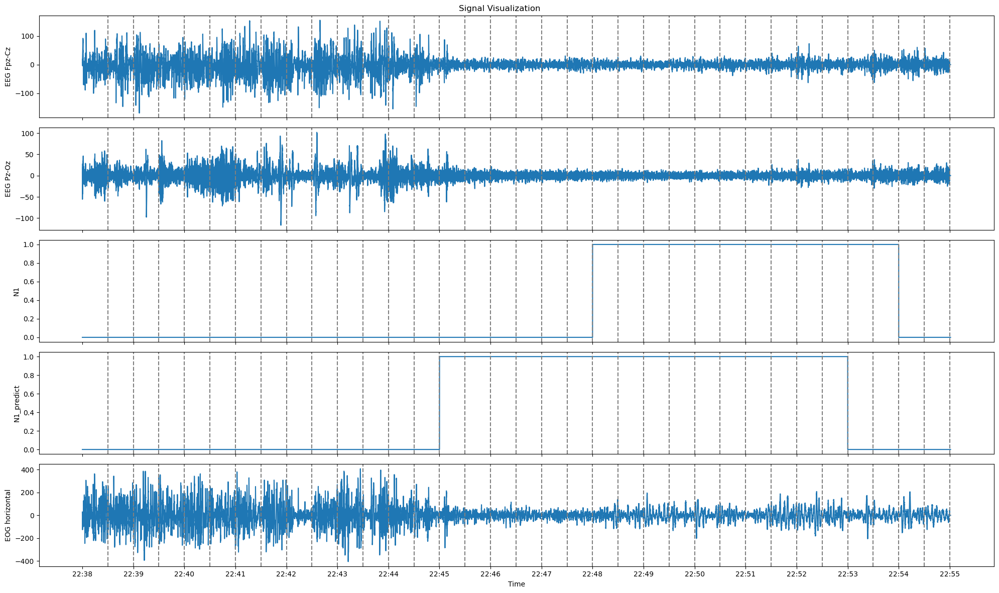

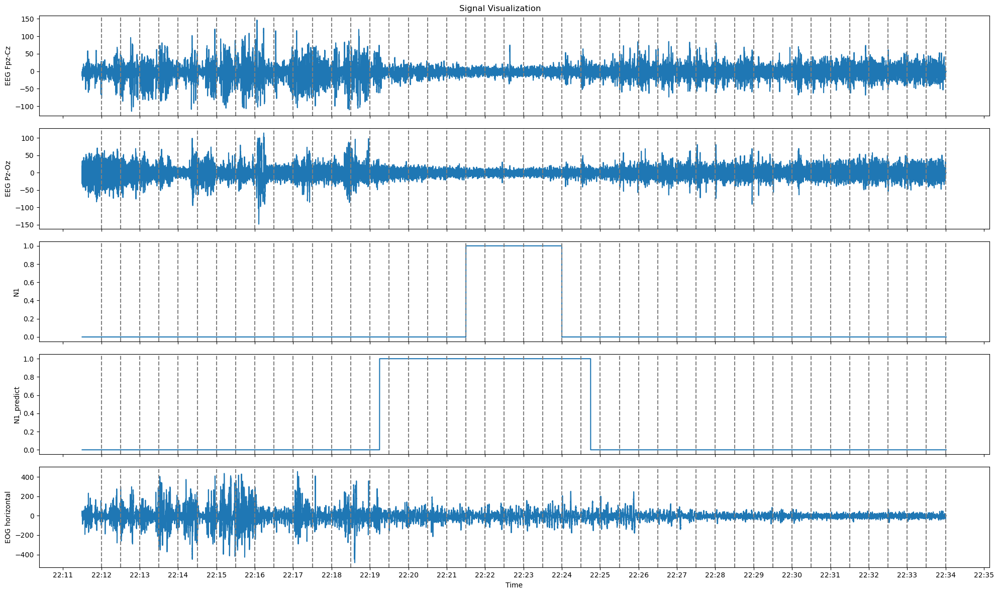

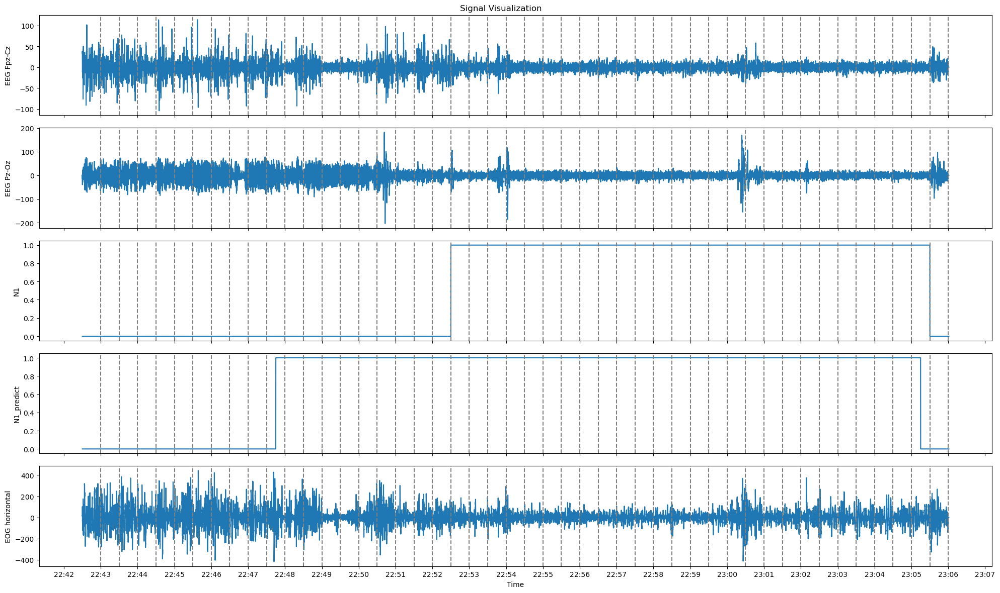

...

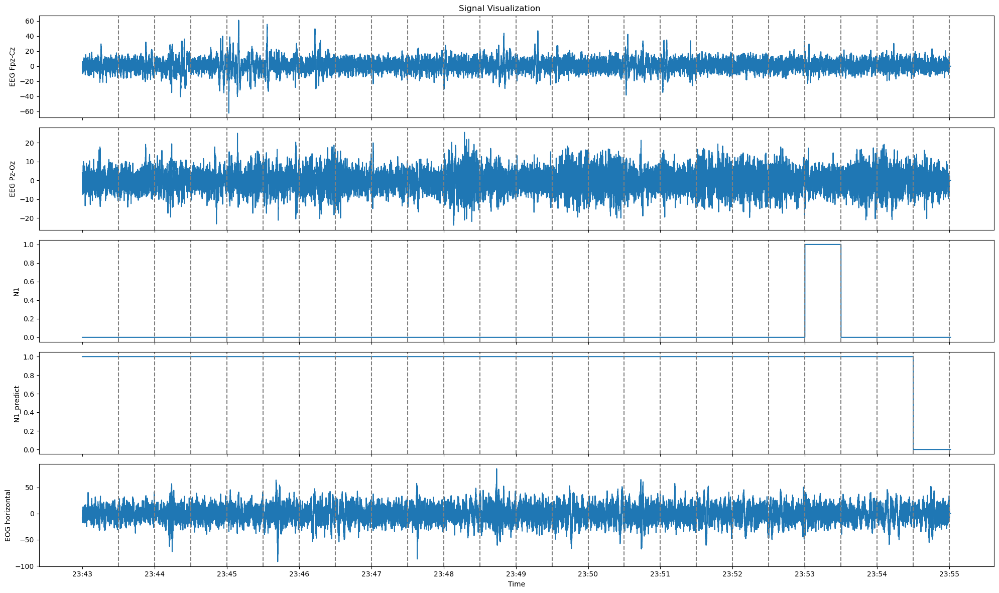

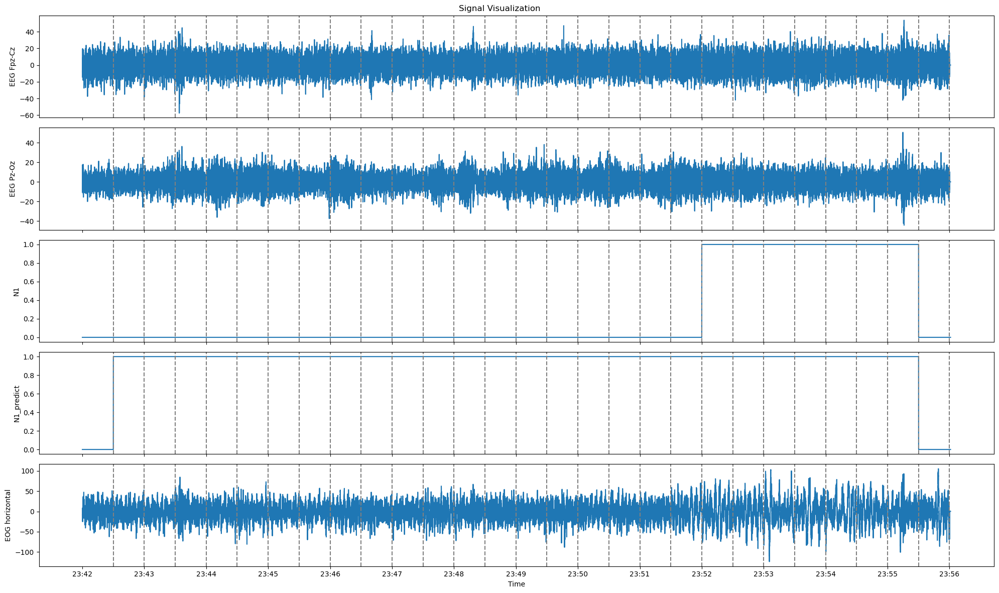

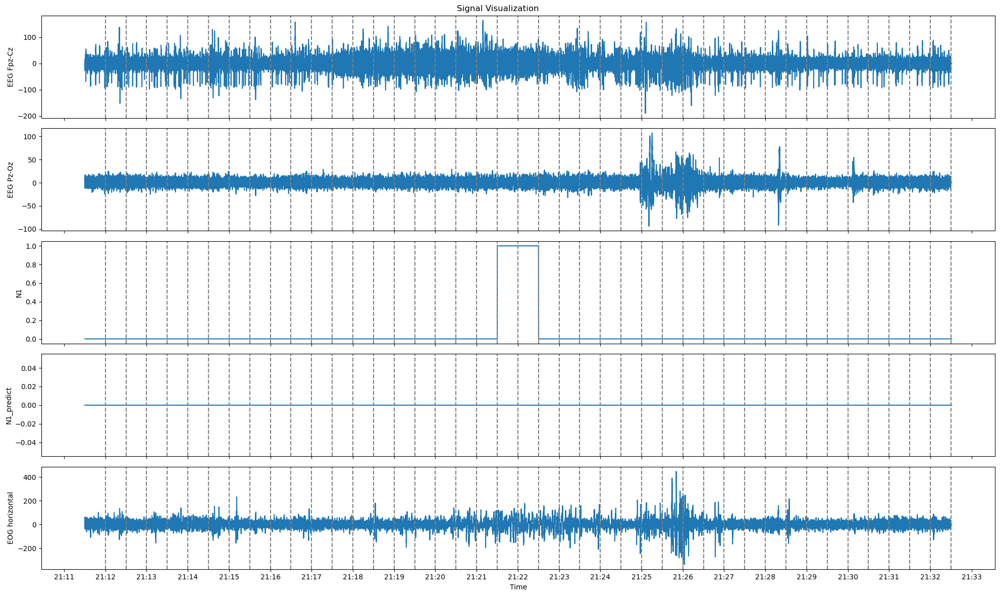

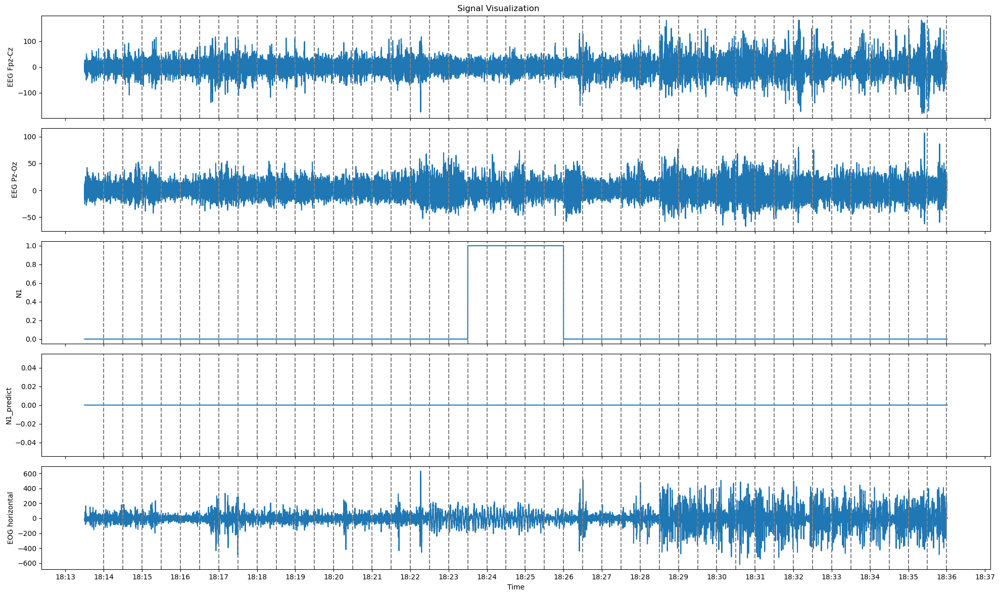

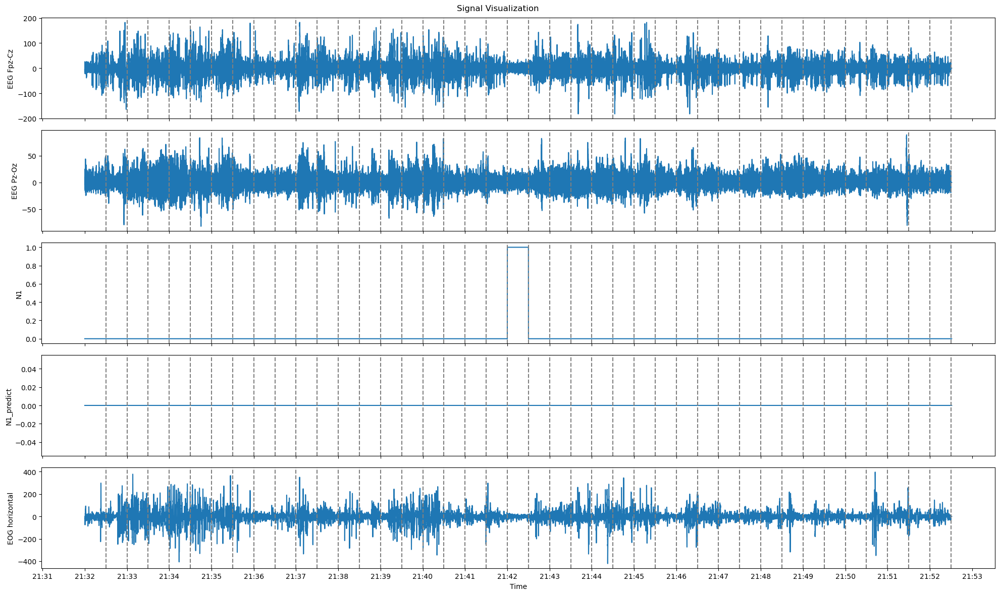

In [5]:
gcount = 0
zero_count = 0
while True:
    gcount += 1
    global psg_id, hypnogram_id
    try:
        psg_id = next(psg_iter)
        hypnogram_id = next(hypnogram_iter)
    except StopIteration:
        print("Iter Stop")
        break
    signal_path = os.path.join(read_folder, f'{psg_id}')
    label_path = os.path.join(read_folder, f'{hypnogram_id}')
    # read EDF files
    if 'edf_label' and 'edf_label' in globals():
        del edf_signal, edf_label
    edf_signal = pyedflib.EdfReader(signal_path)
    edf_label = pyedflib.EdfReader(label_path)

    # read data
    annotations = edf_label.readAnnotations()
    start = edf_signal.getStartdatetime()
    signals, frequencies = edf_signal.getSignalLabels(), edf_signal.getSampleFrequencies()
    data = []
    for ch_idx, sig_name, freq in zip( range(len(signals)), signals, frequencies,):
        sig = edf_signal.readSignal(chn=ch_idx)
        idx = pd.date_range(  start=start, periods=len(sig), freq=pd.Timedelta(1 / freq, unit="s") )
        data += [pd.Series(sig, index=idx, name=sig_name)]
    # create DataFrames
    annotations_df = pd.DataFrame(annotations)
    annotations_df = annotations_df.T
    annotations_df.rename(columns={0: "Onset", 1: "Duration", 2:"Annotations"}, inplace=True)
    signal_df =pd.concat(data[0:2], axis=1)
    signal_df['N1'] = 0

    def check_sleep_stage(row):
        start_time = start + timedelta(seconds = int(annotations_df['Onset'].iloc[1]))
        end_time = start + timedelta(seconds = int(annotations_df['Onset'].iloc[1])) + timedelta(seconds = int(annotations_df['Duration'].iloc[1]))
        if start_time <= pd.to_datetime(row.name) < end_time:
            return int(1)
        else:
            return int(0)

    signal_df['N1'] = signal_df.apply(check_sleep_stage, axis=1)
    signal_df_new = pd.concat([signal_df, data[2]], axis=1)
    signal_df['N1_predict'] = 0

    def check_sleep_stage_predict(row, start_index, duration):
        start_time = start + timedelta(seconds = start_index)
        end_time = start + timedelta(seconds = start_index) + timedelta(seconds = duration)
        if start_time <= pd.to_datetime(row.name) < end_time:
            return int(1)
        else:
            return int(0)
    index = get_n1_index(signal_df, threshold=threshold)
    if len(index) == 0:
        zero_count += 1
        print(psg_id)
        # pass
    elif len(index) == 1:
        signal_df['N1_predict'] = signal_df.apply(check_sleep_stage_predict, args=(int(index[0]/100), int(max(index)/100) + 1.5), axis=1) 
    elif len(index) == 2:
        signal_df['N1_predict'] = signal_df.apply(check_sleep_stage_predict, args=(int(index[0]/100), int(max(index)/100)), axis=1)
    else:
        signal_df['N1_predict'] = signal_df.apply(check_sleep_stage_predict, args=(int(index[0]/100), int((max(index)-index[0])/100)), axis=1)    
    lol(pd.concat([signal_df, data[2]], axis=1))
    print(f"zero_count/total: {zero_count}/{gcount}", end='\r')
    
# print(f"zero_count/total: {zero_count}/{gcount}")

In [6]:
# # 取得資料的欄位數量

# # 設定圖表大小
# signal_df_new = pd.concat([signal_df, data[2]], axis=1)
# lol(signal_df_new)

: 